In [1]:

# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
# TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.

import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil

CHUNK_SIZE = 40960
DATA_SOURCE_MAPPING = 'anime-faces:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F195056%2F432296%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240422%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240422T164605Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3Db57b44b1ac77cc77fd7ef9582379ec58618b5b0c33104ee8ac223e519fdec057164e0e02eb9dafe3a15c7998f88766362ad8dd8887c35718be35223f084bd4d961eae1b88a08a70b48e3d9d3f7f525450ba9aed584a6f1cd6bcbd6fe71e316b295975e8abce633e3906afc54b70d1ac49711dd89dc8915d025dddd7cb4bcafb8de45dba9ebd8458444d57182ad148b92c697f449b9aa6439d8b575b5c56958afaa9aa19200974caf6d5fc6d7b50d300ad56f507dc9f625469dbd3888d4552b8b2d5656e9c502a0dd986911cff77ca8e0c7ce9825096add6202269f27aae5de1dc7ee78762f5be9248f9266a9df9aee73f0db9d2bb682078f77217364b5c37c6d'

KAGGLE_INPUT_PATH='/kaggle/input'
KAGGLE_WORKING_PATH='/kaggle/working'
KAGGLE_SYMLINK='kaggle'

!umount /kaggle/input/ 2> /dev/null
shutil.rmtree('/kaggle/input', ignore_errors=True)
os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

try:
  os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
except FileExistsError:
  pass
try:
  os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
except FileExistsError:
  pass

for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
    directory, download_url_encoded = data_source_mapping.split(':')
    download_url = unquote(download_url_encoded)
    filename = urlparse(download_url).path
    destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
    try:
        with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
            total_length = fileres.headers['content-length']
            print(f'Downloading {directory}, {total_length} bytes compressed')
            dl = 0
            data = fileres.read(CHUNK_SIZE)
            while len(data) > 0:
                dl += len(data)
                tfile.write(data)
                done = int(50 * dl / int(total_length))
                sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                sys.stdout.flush()
                data = fileres.read(CHUNK_SIZE)
            if filename.endswith('.zip'):
              with ZipFile(tfile) as zfile:
                zfile.extractall(destination_path)
            else:
              with tarfile.open(tfile.name) as tarfile:
                tarfile.extractall(destination_path)
            print(f'\nDownloaded and uncompressed: {directory}')
    except HTTPError as e:
        print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
        continue
    except OSError as e:
        print(f'Failed to load {download_url} to path {destination_path}')
        continue

print('Data source import complete.')


[==================================================] 462126466 bytes downloaded
Downloaded and uncompressed: anime-faces
Data source import complete.


## Import Modules

In [2]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img,array_to_img
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

# Load the files

In [3]:
BASE_DIR = '/kaggle/input/anime-faces/data'

In [4]:
# load image path to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR,image_name)
    image_paths.append(image_path)

In [5]:
image_paths[:5]

['/kaggle/input/anime-faces/data/265.png',
 '/kaggle/input/anime-faces/data/20805.png',
 '/kaggle/input/anime-faces/data/18762.png',
 '/kaggle/input/anime-faces/data/1756.png',
 '/kaggle/input/anime-faces/data/3540.png']

In [6]:
len(image_paths)

21552

In [7]:
# Remove unneccesary files
image_paths.remove('/kaggle/input/anime-faces/data/data')

In [8]:
len(image_paths)

21551

## Visualize the image dataset

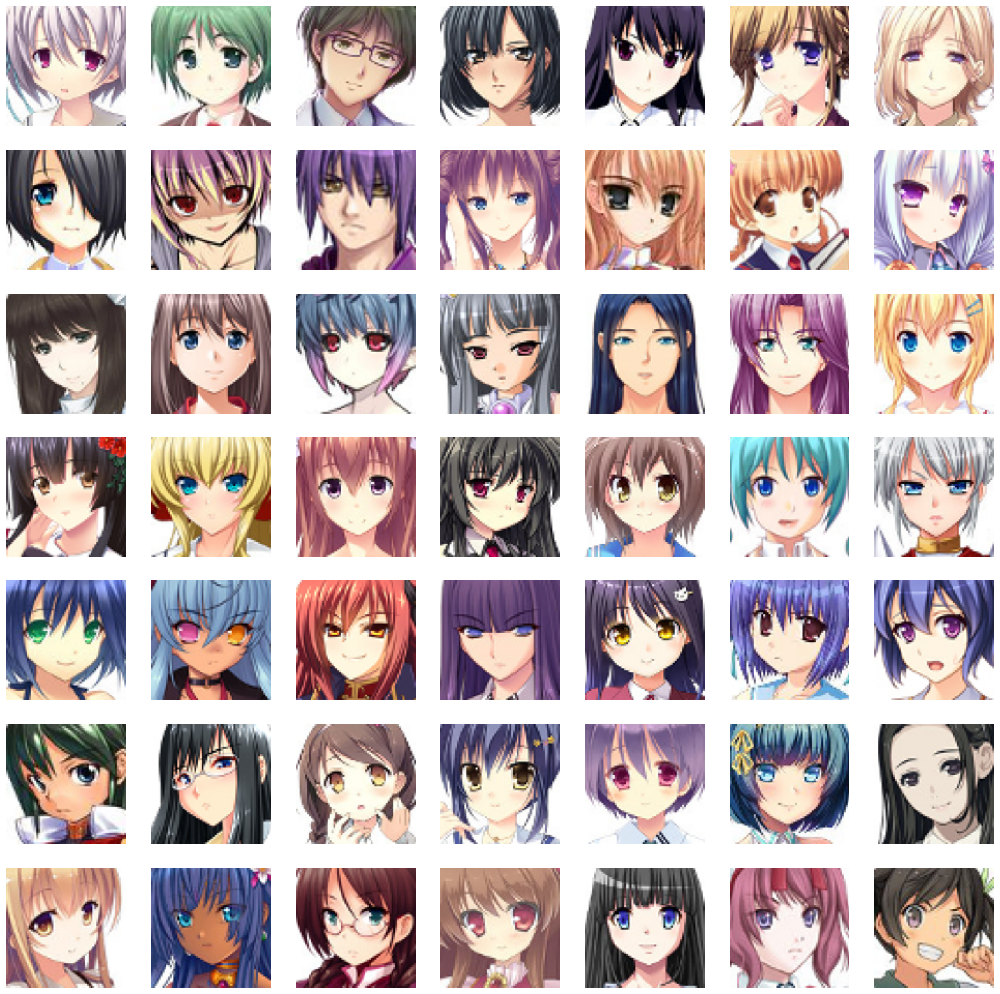

In [9]:
# to display grid of images(7x7)
plt.figure(figsize = (20,20))
temp_images=image_paths[:49]
index=1

for image_path in temp_images:
    plt.subplot(7,7,index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # Incerment the index for next image
    index += 1

## Preprocess Images

In [10]:
# Load the images and convert to numpy array
train_images = [np.array(load_img(path)) for path in tqdm(image_paths)]
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [11]:
train_images.shape

(21551, 64, 64, 3)

In [12]:
train_images[:1].shape

(1, 64, 64, 3)

In [13]:
train_images[:1].dtype

dtype('uint8')

In [14]:
# Reshape and change to float32
train_images = train_images.reshape(train_images.shape[0],64,64,3).astype('float32')

In [15]:
train_images[:1].shape

(1, 64, 64, 3)

In [16]:
# Normalize the images
train_images = (train_images - 127.5) / 127.5

In [17]:
train_images[0]

array([[[ 0.9529412 ,  0.8901961 ,  0.8745098 ],
        [ 0.96862745,  0.90588236,  0.8901961 ],
        [ 0.9607843 ,  0.8745098 ,  0.85882354],
        ...,
        [ 0.81960785,  0.6862745 ,  0.7490196 ],
        [ 1.        ,  0.9137255 ,  0.92156863],
        [ 0.41960785,  0.29411766,  0.4117647 ]],

       [[ 0.9607843 ,  0.90588236,  0.88235295],
        [ 0.84313726,  0.7647059 ,  0.7490196 ],
        [ 0.9372549 ,  0.8509804 ,  0.8352941 ],
        ...,
        [ 0.6392157 ,  0.5058824 ,  0.56078434],
        [ 0.9764706 ,  0.8509804 ,  0.8745098 ],
        [ 0.4509804 ,  0.31764707,  0.44313726]],

       [[ 0.9607843 ,  0.8666667 ,  0.8666667 ],
        [ 0.64705884,  0.5529412 ,  0.5529412 ],
        [ 0.9764706 ,  0.88235295,  0.88235295],
        ...,
        [ 0.3882353 ,  0.23921569,  0.3882353 ],
        [ 0.84313726,  0.70980394,  0.77254903],
        [ 0.45882353,  0.3254902 ,  0.42745098]],

       ...,

       [[ 0.99215686,  0.99215686,  0.99215686],
        [ 0

## Create Generator and Discriminator

In [18]:
# Latent dimension for random noise
LATENT_DIM = 100
# Weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0,stddev=0.02)
# mo.of channels of the image
CHANNELS = 3 # for graysclae keep it 1

## Generator model

In [19]:
model = Sequential(name='generator')

#1d random noise
model.add(layers.Dense(8*8*512, input_dim=LATENT_DIM))
model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8,8,512)))
#upsample to 16x16
model.add(layers.Conv2DTranspose(256,(4,4),strides=(2,2),padding='same',kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())
#upsample to 32x32
model.add(layers.Conv2DTranspose(128,(4,4),strides=(2,2),padding='same',kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())
#upsample to 64x64
model.add(layers.Conv2DTranspose(64,(4,4),strides=(2,2),padding='same',kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

# Final layer
model.add(layers.Conv2D(CHANNELS,(4,4),padding='same',activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 batch_normalization (Batch  (None, 32768)             131072    
 Normalization)                                                  
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 16, 16, 256)       2097408   
 anspose)                                                        
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0 

## Disvriminator model

In [20]:
model = Sequential(name = 'discriminator')
input_shape = (64,64,3)
alpha=0.2

# Create conv layers
model.add(layers.Conv2D(64,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

# Create conv layers
model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))
# Create conv layers
model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# Output class
model.add(layers.Dense(1,activation='sigmoid'))

discriminator = model

discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization_1 (Bat  (None, 32, 32, 64)        256       
 chNormalization)                                                
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_2 (Bat  (None, 16, 16, 128)       512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)     

## Training Process

In [21]:
class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        # get batch size from the data
        batch_size = tf.shape(real_images)[0]
        # generate random noise
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # train the discriminator with real (1) and fake (0) images
        with tf.GradientTape() as tape:
            # compute loss on real images
            pred_real = self.discriminator(real_images, training=True)
            # generate real image labels
            real_labels = tf.ones((batch_size, 1))
            # label smoothing
            real_labels += 0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels, pred_real)

            # compute loss on fake images
            fake_images = self.generator(random_noise)
            pred_fake = self.discriminator(fake_images, training=True)
            # generate fake labels
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            # total discriminator loss
            d_loss = (d_loss_real + d_loss_fake) / 2

        # compute discriminator gradients
        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        # update the gradients
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))


        # train the generator model
        labels = tf.ones((batch_size, 1))
        # generator want discriminator to think that fake images are real
        with tf.GradientTape() as tape:
            # generate fake images from generator
            fake_images = self.generator(random_noise, training=True)
            # classify images as real or fake
            pred_fake = self.discriminator(fake_images, training=True)
            # compute loss
            g_loss = self.loss_fn(labels, pred_fake)

        # compute gradients
        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        # update the gradients
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # update states for both models
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(), 'g_loss': self.g_loss_metric.result()}

In [22]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        # plt.savefig('epoch_{:03d}.png'.format(epoch))
        plt.show()

    def on_train_end(self, logs=None):
        self.model.generator.save('generator.h5')

In [23]:
dcgan = DCGAN(generator,discriminator,latent_dim=LATENT_DIM)

In [24]:
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR,beta_1=0.5),d_optimizer=Adam(learning_rate=D_LR,beta_1=0.5),loss_fn = BinaryCrossentropy())

Epoch 1/50
674/674 [==============================] - ETA: 0s - d_loss: 0.6619 - g_loss: 2.3998

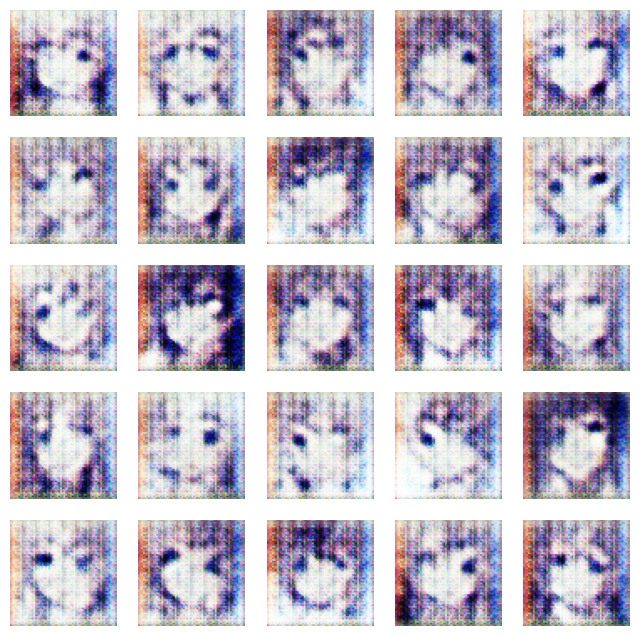

674/674 [==============================] - 55s 65ms/step - d_loss: 0.6619 - g_loss: 2.3998
Epoch 2/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7817 - g_loss: 0.8399

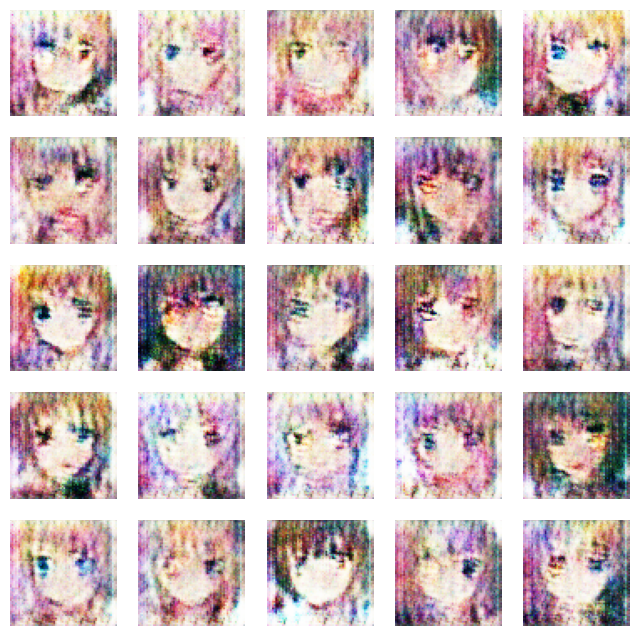

674/674 [==============================] - 45s 66ms/step - d_loss: 0.7816 - g_loss: 0.8396
Epoch 3/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7728 - g_loss: 0.7390

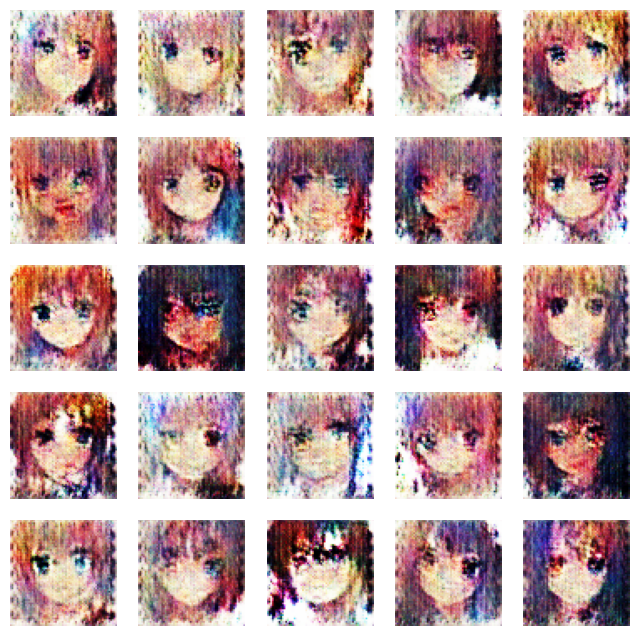

674/674 [==============================] - 45s 66ms/step - d_loss: 0.7730 - g_loss: 0.7388
Epoch 4/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7563 - g_loss: 0.7097

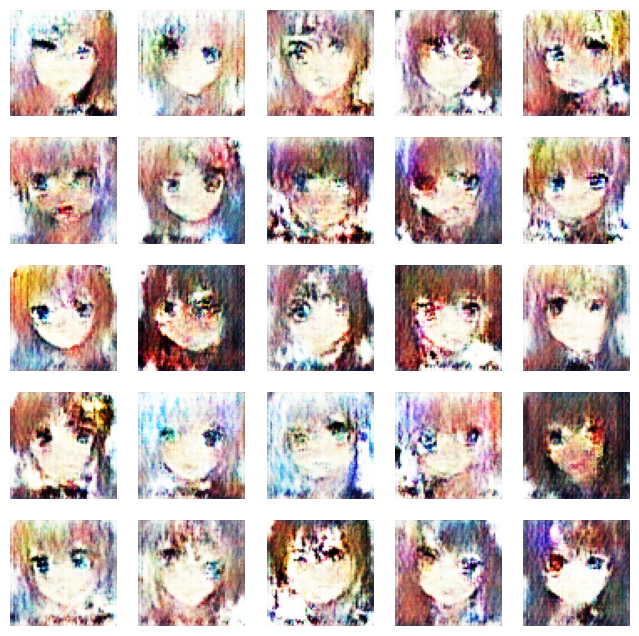

674/674 [==============================] - 45s 66ms/step - d_loss: 0.7564 - g_loss: 0.7097
Epoch 5/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7427 - g_loss: 0.7003

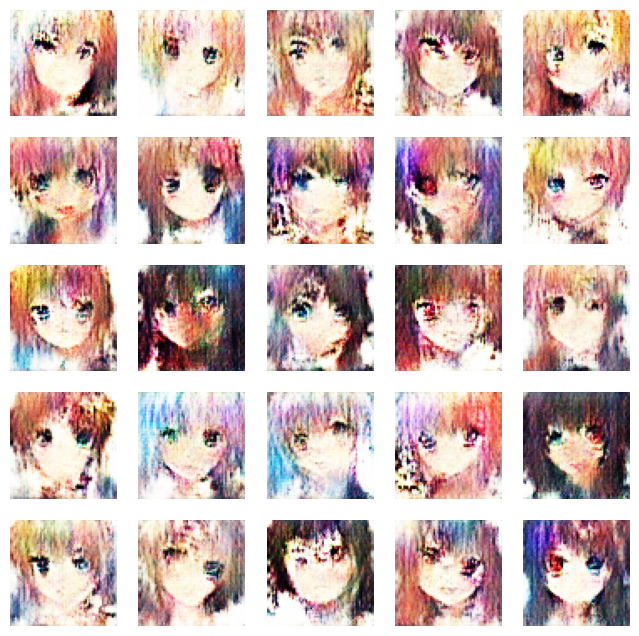

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7426 - g_loss: 0.7003
Epoch 6/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7263 - g_loss: 0.7032

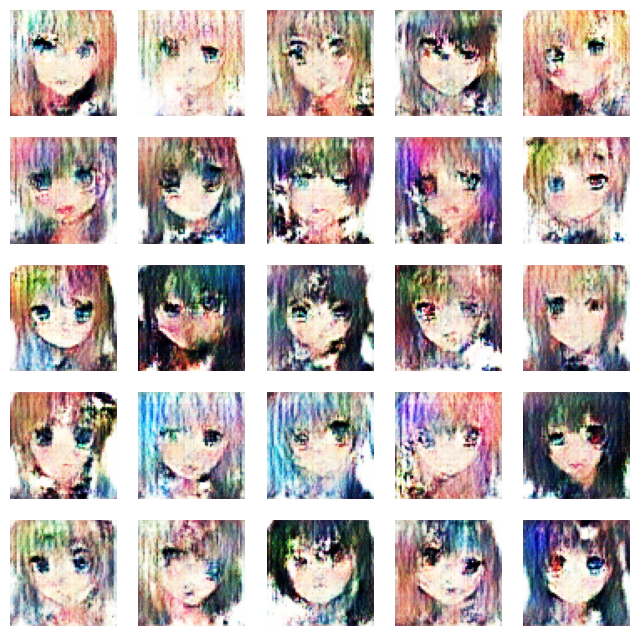

674/674 [==============================] - 45s 66ms/step - d_loss: 0.7262 - g_loss: 0.7030
Epoch 7/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7216 - g_loss: 0.7072

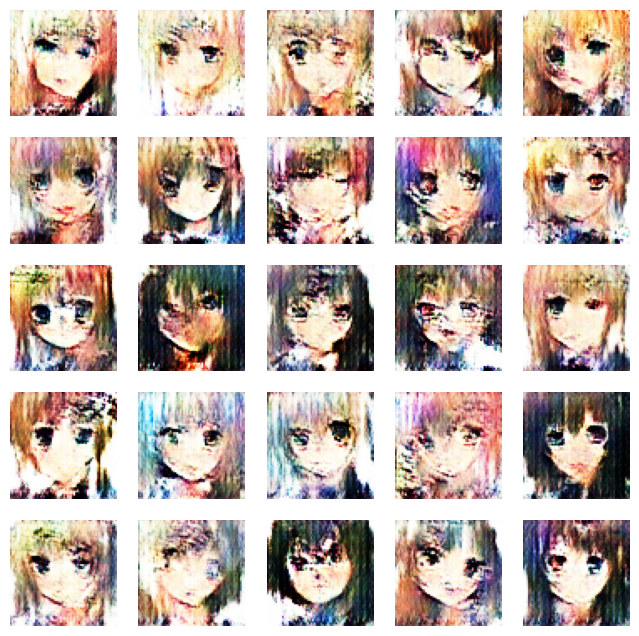

674/674 [==============================] - 46s 68ms/step - d_loss: 0.7216 - g_loss: 0.7070
Epoch 8/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7230 - g_loss: 0.6990

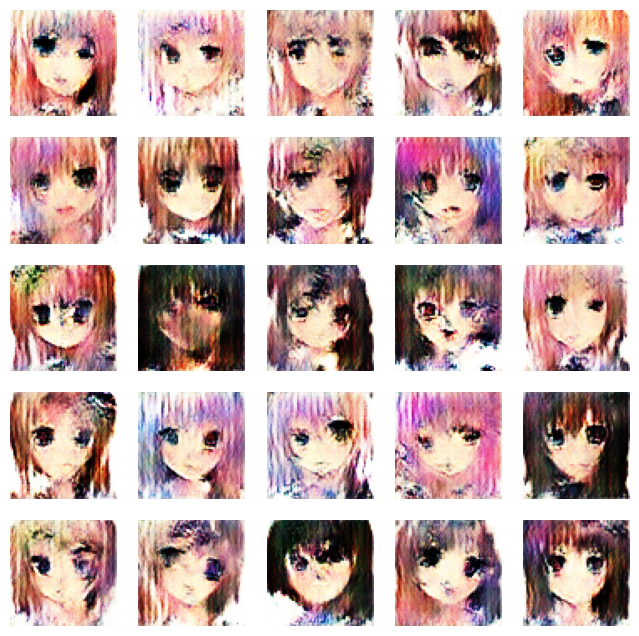

674/674 [==============================] - 46s 68ms/step - d_loss: 0.7231 - g_loss: 0.6989
Epoch 9/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7181 - g_loss: 0.6904

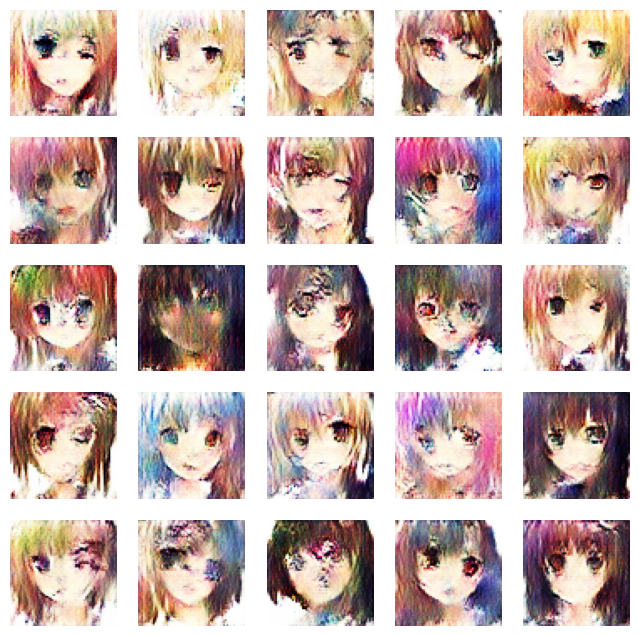

674/674 [==============================] - 46s 68ms/step - d_loss: 0.7181 - g_loss: 0.6903
Epoch 10/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7153 - g_loss: 0.6905

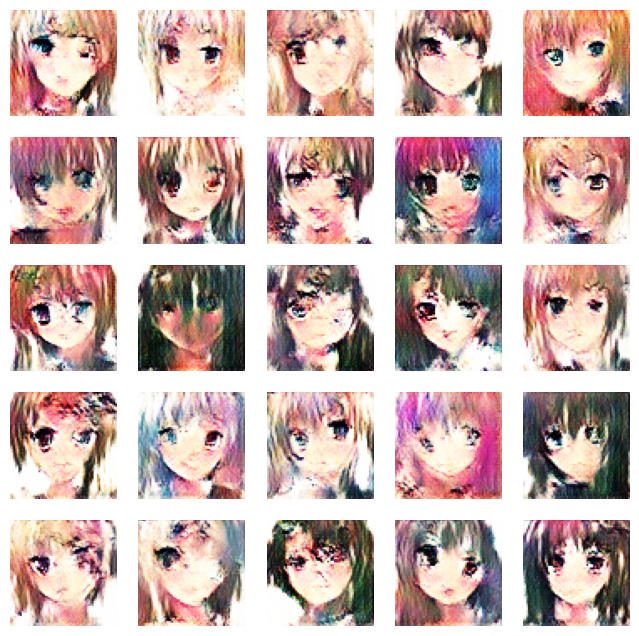

674/674 [==============================] - 46s 68ms/step - d_loss: 0.7153 - g_loss: 0.6905
Epoch 11/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7125 - g_loss: 0.6940

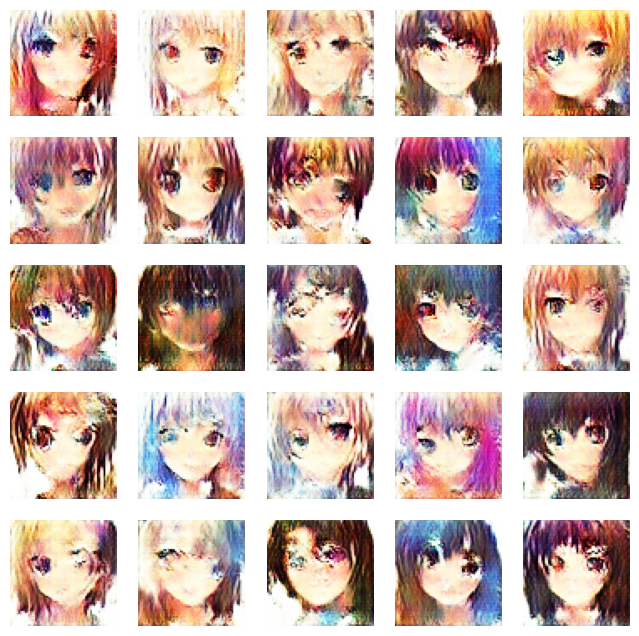

674/674 [==============================] - 46s 68ms/step - d_loss: 0.7125 - g_loss: 0.6940
Epoch 12/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7095 - g_loss: 0.6936

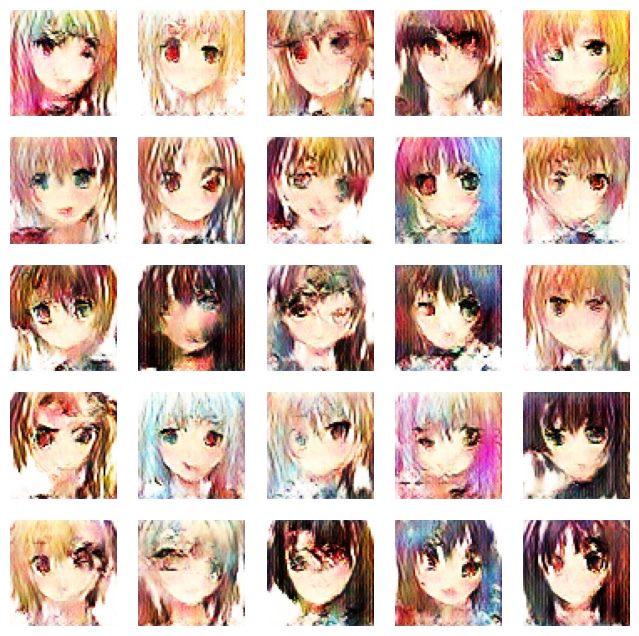

674/674 [==============================] - 45s 68ms/step - d_loss: 0.7095 - g_loss: 0.6936
Epoch 13/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7072 - g_loss: 0.7106

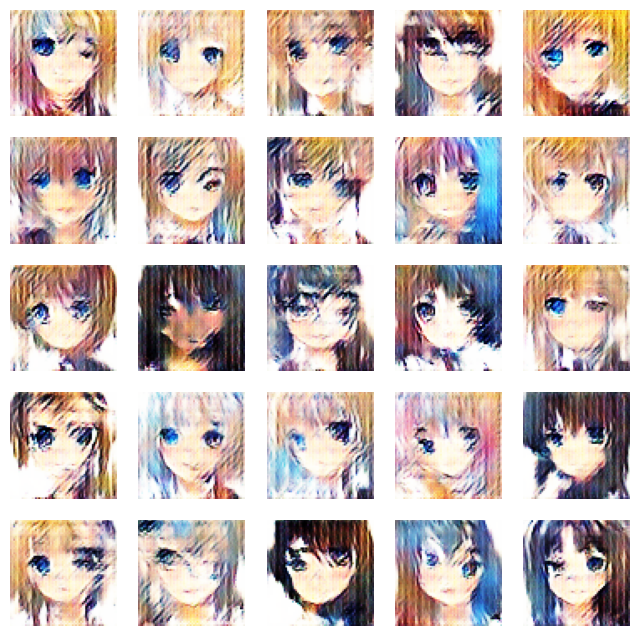

674/674 [==============================] - 46s 68ms/step - d_loss: 0.7071 - g_loss: 0.7106
Epoch 14/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7087 - g_loss: 0.6921

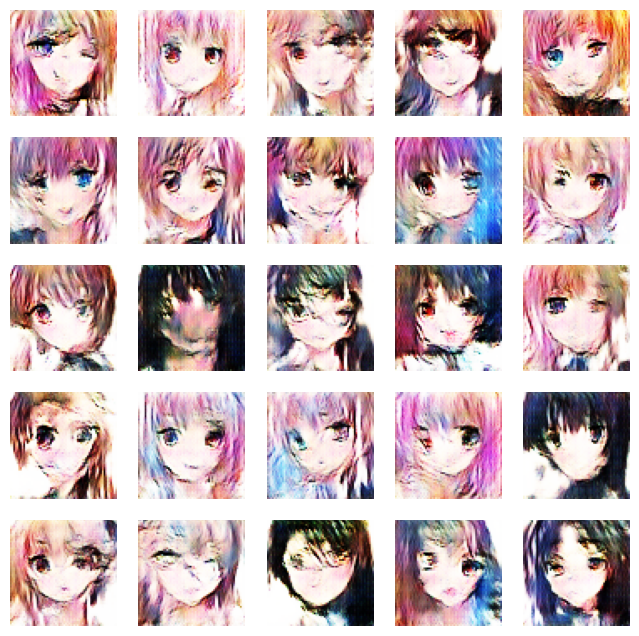

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7087 - g_loss: 0.6921
Epoch 15/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7103 - g_loss: 0.6927

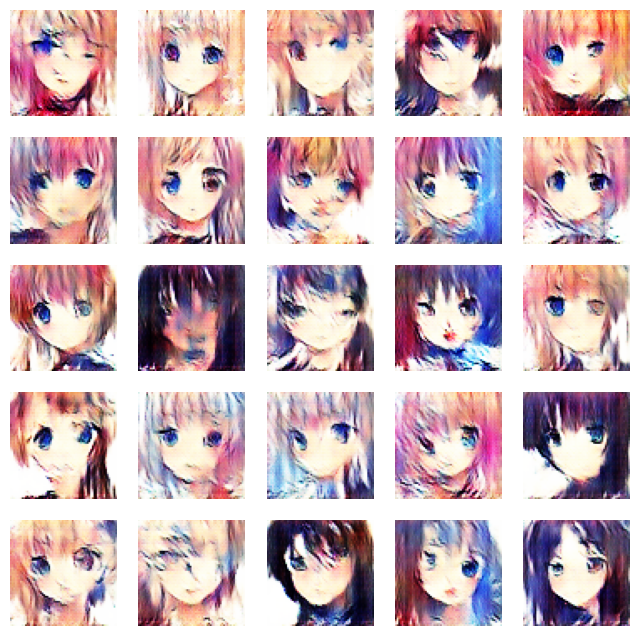

674/674 [==============================] - 46s 68ms/step - d_loss: 0.7103 - g_loss: 0.6927
Epoch 16/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7089 - g_loss: 0.6906

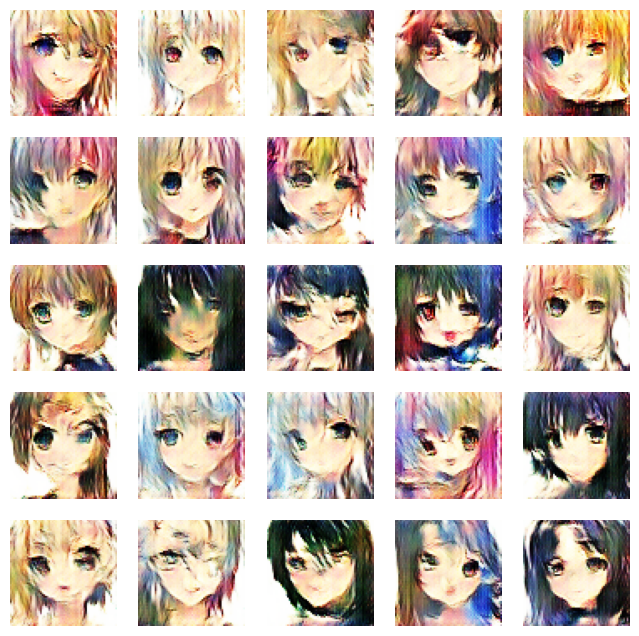

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7089 - g_loss: 0.6905
Epoch 17/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7073 - g_loss: 0.6889

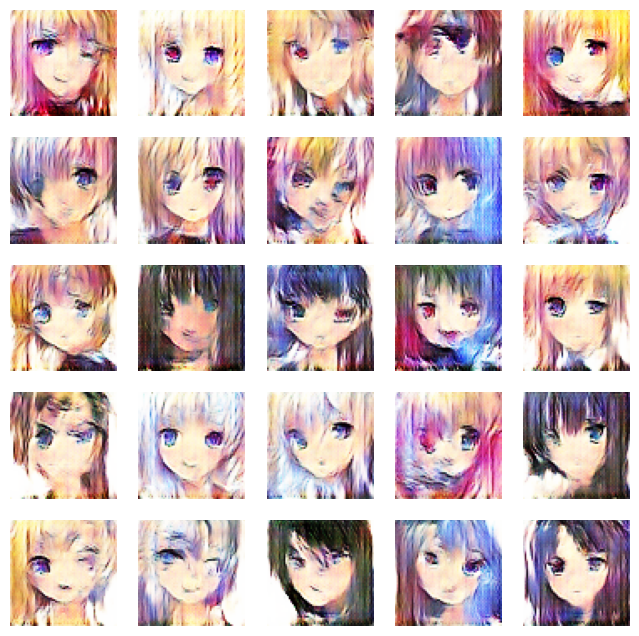

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7072 - g_loss: 0.6890
Epoch 18/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7075 - g_loss: 0.6891

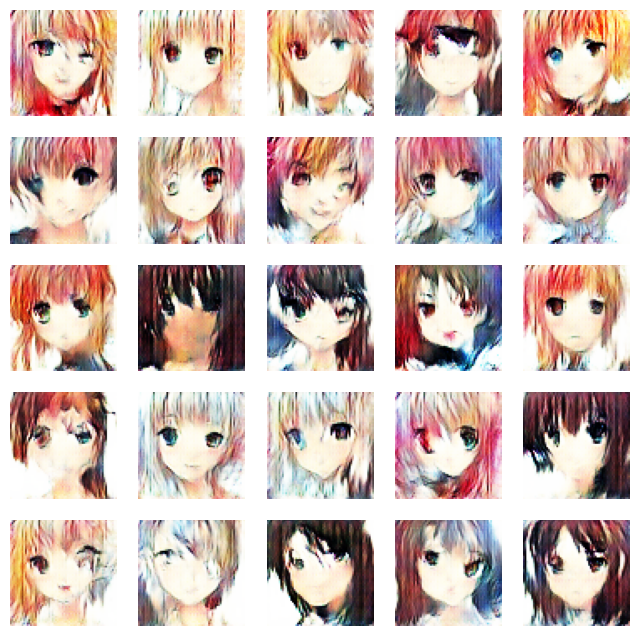

674/674 [==============================] - 46s 68ms/step - d_loss: 0.7075 - g_loss: 0.6891
Epoch 19/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7070 - g_loss: 0.6860

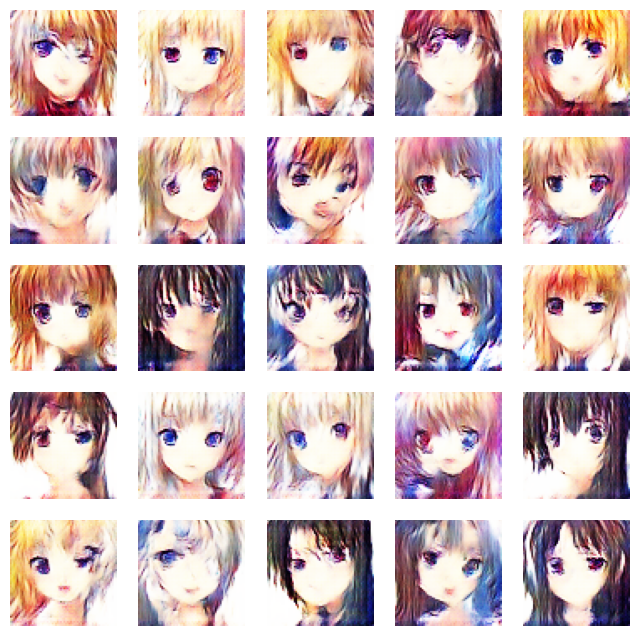

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7070 - g_loss: 0.6861
Epoch 20/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7064 - g_loss: 0.6876

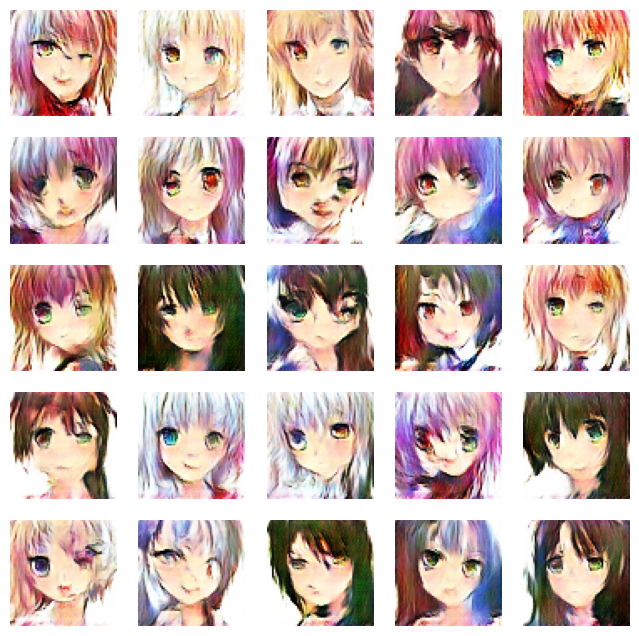

674/674 [==============================] - 46s 68ms/step - d_loss: 0.7065 - g_loss: 0.6876
Epoch 21/50
673/674 [============================>.] - ETA: 0s - d_loss: 0.7057 - g_loss: 0.6849

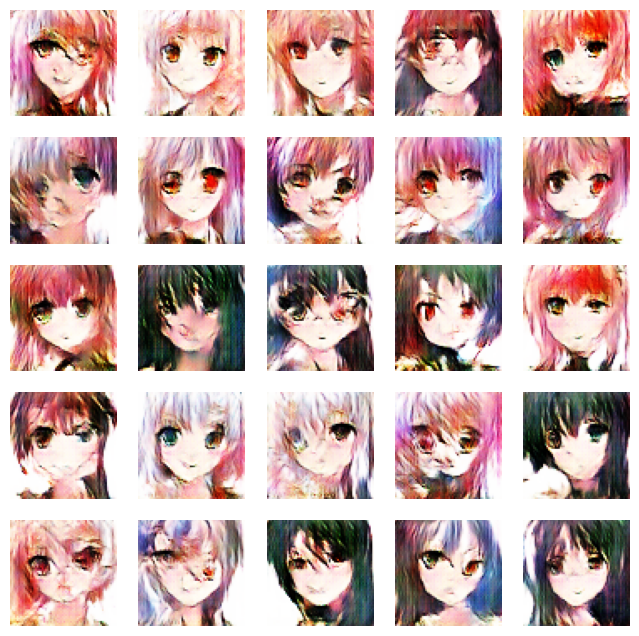

674/674 [==============================] - 46s 68ms/step - d_loss: 0.7057 - g_loss: 0.6849
Epoch 22/50
555/674 [=======================>......] - ETA: 7s - d_loss: 0.7055 - g_loss: 0.6906

In [ ]:
dcgan.fit(train_images , epochs = 50, callbacks = [DCGANMonitor()])

In [ ]:
noise = tf.random.normal([1,100])
fig = plt.figure(figsize=(3,3))
# generate the image from thr noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()

In [ ]:
#import pickle

# Save the generator model as a pickle file
#with open('generator.pkl', 'wb') as file:
    #pickle.dump(dcgan.generator, file)

In [ ]:
dcgan.generator.save('generator.h5')